In [1]:
#Import pycaret
from pycaret.classification import *
import pandas as pd

In [2]:
from pycaret.utils import version
version()

'2.3.4'

In [3]:
df=pd.read_csv('Data.csv')


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 681456 entries, 0 to 681455
Data columns (total 19 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   PRODUCT_CODE                659606 non-null  object 
 1   DOC                         681456 non-null  object 
 2   EXPIRY_DATE                 681456 non-null  object 
 3   PRODUCT_TYPE                681456 non-null  object 
 4   TERMINATION_EFFECTIVE_DATE  623016 non-null  object 
 5   TERM                        681456 non-null  int64  
 6   PREMIUM_AMOUNT              681395 non-null  float64
 7   SA                          681456 non-null  float64
 8   STATUS_NAME                 681456 non-null  object 
 9   PREMIUM_STATUS              681456 non-null  object 
 10  PREMIUM_FREQUENCY           681456 non-null  object 
 11  MODE_NAME                   681456 non-null  object 
 12  GENDER                      681456 non-null  object 
 13  MARITAL_STATUS

In [5]:
df.EDUCATION.unique()

array(['Others', 'Unknown', nan], dtype=object)

In [6]:
df.columns

Index(['PRODUCT_CODE', 'DOC', 'EXPIRY_DATE', 'PRODUCT_TYPE',
       'TERMINATION_EFFECTIVE_DATE', 'TERM', 'PREMIUM_AMOUNT', 'SA',
       'STATUS_NAME', 'PREMIUM_STATUS', 'PREMIUM_FREQUENCY', 'MODE_NAME',
       'GENDER', 'MARITAL_STATUS', 'EDUCATION', 'BIRTHDAY', 'INCOME',
       'SALES_CHANNEL', 'AGENT_PERSISTENCY'],
      dtype='object')

In [7]:
#remove date collumns
# convert the 'Date' column to datetime format
df['TERMINATION_EFFECTIVE_DATE']= pd.to_datetime(df['TERMINATION_EFFECTIVE_DATE'])
df['BIRTHDAY']= pd.to_datetime(df['BIRTHDAY'])
df['DOC']= pd.to_datetime(df['DOC'])


#Etract the age from  birth year
#soucrce: https://stackoverflow.com/questions/2217488/age-from-birthdate-in-python
from datetime import date

def calculate_age(born):
    #today = date.today()
    twenty20 = date(2020, 12, 30)
    return twenty20.year - born.year - ((twenty20.month, twenty20.day) < (born.month, born.day))




#Calculate the policy age

df['Policy_Age'] = df['DOC'].apply(calculate_age)
df['Policy_holder_Age'] = df['BIRTHDAY'].apply(calculate_age)

df = df[df.columns.difference(['DOC', 'BIRTHDAY','TERMINATION_EFFECTIVE_DATE','EXPIRY_DATE','CLAWBACK_COMMISSION'])]


In [8]:
df.shape

(681456, 17)

In [9]:
df.head()


,AGENT_PERSISTENCY,EDUCATION,GENDER,INCOME,MARITAL_STATUS,MODE_NAME,PREMIUM_AMOUNT,PREMIUM_FREQUENCY,PREMIUM_STATUS,PRODUCT_CODE,PRODUCT_TYPE,Policy_Age,Policy_holder_Age,SA,SALES_CHANNEL,STATUS_NAME,TERM
0,86.41,Others,M,111600.0,Single,GSO,302.39,Monthly,Regular,BMFW-1,Risk,12,55,13439.160,Tied,Terminated,7991
1,90.25,Others,F,60396.0,Single,DDE,307.74,Monthly,Regular,BMFW-1,Risk,14,47,22689.950,Broker,Lapsed,7992
2,0.00,Others,M,48108.0,Married,GSO,276.58,Monthly,Regular,BMFW-1,Risk,14,65,15938.480,Tied,Terminated,7992
3,86.62,Others,M,24000.0,Single,Cash,207.73,Monthly,Regular,BMFW-1,Risk,11,42,11940.525,Tied,Lapsed,7990
4,82.86,Others,M,55632.0,Married,ESO(Electronic),198.43,Monthly,Regular,BMFW-1,Risk,13,55,12298.740,Broker,Terminated,7992


In [10]:
df.EDUCATION.unique()

array(['Others', 'Unknown', nan], dtype=object)

In [11]:
#Dropt 'Termination reason collumn as it gives away the class'
df.drop(df[df['STATUS_NAME'] == 'Waiting for Validate'].index, inplace = True)
df.drop(df[df['STATUS_NAME'] == 'Terminated'].index, inplace = True)

In [12]:
df.shape

(389153, 17)

In [13]:
#Check if the waiting for validate has been removed
df.STATUS_NAME.unique()

array(['Lapsed', 'Inforce'], dtype=object)

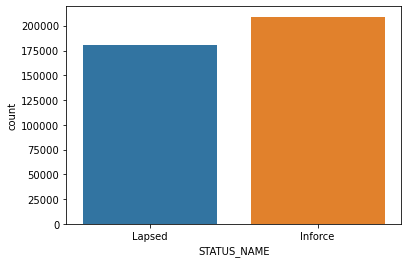

In [14]:
#Simple count plot for class balance inestigation
import seaborn as sns
ax = sns.countplot(x="STATUS_NAME", data=df)

The above plot shows more policies have been terminated foe the data 2014 to 2020.

Data set currently seats at 600k rows. This might be too expensive for computation.
Maybe sampling the data would help reduce that.


In [15]:
#random sample
df2=df.sample(n=50000,replace="False",random_state=8755)
df2.shape

(50000, 17)

In [16]:
import dtale as dt
dash=dt.show(df2)
dash.open_browser()

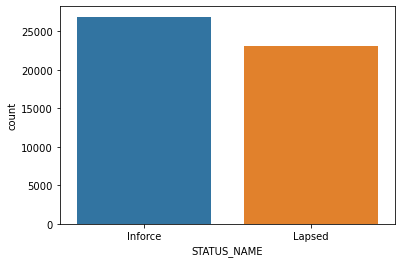

In [17]:
#Check class balance of the sample
#Simple count plot for class balance inestigation
import seaborn as sns
ax = sns.countplot(x="STATUS_NAME", data=df2)

# EDA

In [15]:
from dataprep.eda import plot, plot_correlation, plot_missing
import pandas as pd

In [16]:
# convert the 'Date' column to datetime format
#df['BIRTHDAY']= pd.to_datetime(df['BIRTHDAY'])
#df['DOC']= pd.to_datetime(df['DOC'])
#df['EXPIRY_DATE']= pd.to_datetime(df['EXPIRY_DATE'])


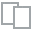
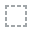
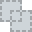
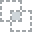
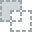
...
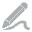
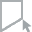
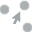
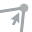
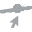

In [95]:
plot(df, "BIRTHDAY",'STATUS_NAME')

DataPrep Report
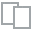
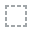
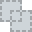
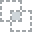
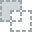
...
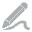
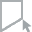
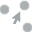
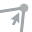
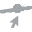

In [91]:
from dataprep.eda import create_report
create_report(df)

# Modelling

Seems reasonable to proceed.

In [18]:
#Set up an experiement
exp=setup(df2,target='STATUS_NAME',train_size=0.7,
          imputation_type='simple',
          ignore_low_variance=True,
          numeric_imputation='mean',categorical_imputation='mode',
          fix_imbalance=True,
          normalize=True ,  #Rescaling
          transformation= True,
          feature_interaction=True,
          feature_ratio= True,
          feature_selection= True,   #new
          feature_selection_threshold= 0.2,  #new
          bin_numeric_features=['Policy_holder_Age','INCOME'],
          session_id= 8755, # control randomness,
          fold_strategy='kfold',
          high_cardinality_features=['PRODUCT_CODE']  #new
          
          )

,Description,Value
0,session_id,8755
1,Target,STATUS_NAME
2,Target Type,Binary
3,Label Encoded,"Inforce: 0, Lapsed: 1"
4,Original Data,"(50000, 17)"
5,Missing Values,True
6,Numeric Features,7
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,True


2021-10-04 11:19:13,807 - INFO     - create_model_container: 0
2021-10-04 11:19:13,809 - INFO     - master_model_container: 0
2021-10-04 11:19:13,810 - INFO     - display_container: 1
2021-10-04 11:19:13,818 - INFO     - Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[],
                                      target='STATUS_NAME', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_s...
                 Advanced_Feature_Selection_Classic(ml_usecase='c

In [19]:
data_feature_engginerring=get_config('X')

2021-10-04 11:19:17,102 - INFO     - Initializing get_config()
2021-10-04 11:19:17,102 - INFO     - get_config(variable=X)
2021-10-04 11:19:17,113 - INFO     - Global variable: X returned as         SALES_CHANNEL_Broker  MODE_NAME_ESO(Electronic)  GENDER_F  Policy_Age  \
639047                   0.0                        0.0       1.0   -0.998204   
429033                   1.0                        0.0       0.0   -0.998204   
661082                   0.0                        0.0       0.0    0.468417   
145821                   1.0                        0.0       0.0    1.146821   
592913                   0.0                        0.0       0.0   -0.617459   
...                      ...                        ...       ...         ...   
427613                   1.0                        0.0       0.0   -0.998204   
416878                   0.0                        0.0       0.0   -0.998204   
564654                   0.0                        0.0       0.0    0.468417   

In [36]:
data_feature_engginerring.columns

Index(['SALES_CHANNEL_Broker', 'MODE_NAME_ESO(Electronic)', 'GENDER_F',
       'Policy_Age', 'PREMIUM_AMOUNT', 'AGENT_PERSISTENCY', 'MODE_NAME_DDE',
       'TERM', 'GENDER_N', 'MODE_NAME_GSO', 'INCOME_9.0',
       'MODE_NAME_Electronic Cash Collection', 'PRODUCT_TYPE_Risk',
       'MODE_NAME_Cash', 'PRODUCT_CODE', 'SA', 'MARITAL_STATUS_Single',
       'TERM_divide_SA', 'MODE_NAME_GSO_multiply_Policy_Age',
       'MARITAL_STATUS_Single_multiply_TERM', 'SA_divide_Policy_Age',
       'MARITAL_STATUS_Single_multiply_Policy_Age',
       'PRODUCT_TYPE_Risk_multiply_TERM', 'TERM_multiply_Policy_Age',
       'PRODUCT_TYPE_Risk_multiply_Policy_Age'],
      dtype='object')

In [74]:
#get the pipeline
pipeline=get_config('prep_pipe')
pipeline

2021-10-05 09:02:26,009 - INFO     - Initializing get_config()
2021-10-05 09:02:26,009 - INFO     - get_config(variable=prep_pipe)
2021-10-05 09:02:26,020 - INFO     - Global variable: prep_pipe returned as Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[],
                                      target='STATUS_NAME', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_s...
                 Advanced_Feature_Selection_Classic(ml_usecase='classification'

Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[],
                                      target='STATUS_NAME', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_s...
                 Advanced_Feature_Selection_Classic(ml_usecase='classification',
                                                    n_jobs=-1,
                                                    random_state=8755,
                                                    subclass='binary',


In [53]:
import joblib
joblib.dump(pipeline, 'pipeline.pkl')

['pipeline.pkl']

2021-10-04 11:19:23,448 - INFO     - Initializing get_config()
2021-10-04 11:19:23,449 - INFO     - get_config(variable=y_train)
2021-10-04 11:19:23,451 - INFO     - Global variable: y_train returned as 581434    1
343443    0
326250    1
384537    1
509408    1
         ..
565974    1
63660     1
104550    1
445004    0
205657    0
Name: STATUS_NAME, Length: 34999, dtype: int32
2021-10-04 11:19:23,451 - INFO     - get_config() succesfully completed......................................


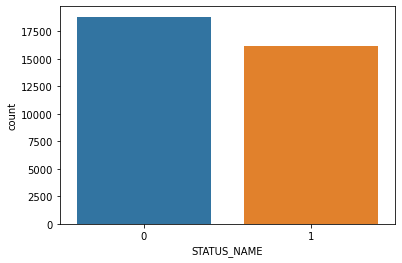

In [22]:
Target=get_config('y_train')
ax = sns.countplot(Target)


Note that there are about 50 parameters we can tune here as pre-processing step prior to modelling

In [23]:
#Custom metric
import numpy as np
def calc_profit(y,y_pred):
    true_postives=np.where((y_pred==1) & (y==1),(5000-1000),0)
    false_postives=np.where((y_pred==1) & (y==0),-1000,0)
    return np.sum([true_postives,false_postives])

In [24]:
add_metric('profit','Profit',calc_profit)

Name                                                       Profit
Display Name                                               Profit
Score Function       <function calc_profit at 0x00000221D3EA91F0>
Scorer                                   make_scorer(calc_profit)
Target                                                       pred
Args                                                           {}
Greater is Better                                            True
Multiclass                                                   True
Custom                                                       True
Name: profit, dtype: object

In [32]:
# return best model
Models = compare_models(round=2,turbo=True,verbose=True,cross_validation=True,sort='recall')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
xgboost,Extreme Gradient Boosting,0.85,0.93,0.88,0.81,0.84,0.70,0.70,2.21
lightgbm,Light Gradient Boosting Machine,0.84,0.93,0.87,0.81,0.84,0.69,0.69,0.86
rf,Random Forest Classifier,0.84,0.92,0.86,0.81,0.83,0.68,0.69,1.71
gbc,Gradient Boosting Classifier,0.83,0.91,0.86,0.78,0.82,0.65,0.66,2.50
dt,Decision Tree Classifier,0.82,0.84,0.85,0.77,0.81,0.63,0.64,0.43
et,Extra Trees Classifier,0.83,0.91,0.85,0.80,0.82,0.66,0.66,1.63
ada,Ada Boost Classifier,0.81,0.90,0.84,0.77,0.80,0.62,0.62,0.89
lr,Logistic Regression,0.80,0.88,0.83,0.76,0.79,0.60,0.60,1.63
ridge,Ridge Classifier,0.80,0.00,0.82,0.76,0.79,0.60,0.60,0.36
lda,Linear Discriminant Analysis,0.80,0.88,0.82,0.76,0.79,0.60,0.60,0.46


2021-09-23 15:36:43,522 - INFO     - create_model_container: 14
2021-09-23 15:36:43,522 - INFO     - master_model_container: 14
2021-09-23 15:36:43,522 - INFO     - display_container: 2
2021-09-23 15:36:43,530 - INFO     - XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0)
2021-09-23 15:36:43,530 - INFO     - compare_models() succesfully completed......................................


In [20]:
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [96]:
#24 features (0.2)
Models2 = compare_models(round=2,turbo=True,verbose=True,cross_validation=True)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit,TT (Sec)
xgboost,Extreme Gradient Boosting,0.85,0.93,0.88,0.81,0.84,0.70,0.70,5345300.00,2.54
rf,Random Forest Classifier,0.84,0.93,0.86,0.81,0.83,0.69,0.69,5236000.00,1.68
lightgbm,Light Gradient Boosting Machine,0.84,0.93,0.87,0.80,0.84,0.69,0.69,5306100.00,0.91
gbc,Gradient Boosting Classifier,0.83,0.92,0.86,0.78,0.82,0.65,0.66,5183200.00,2.81
et,Extra Trees Classifier,0.83,0.91,0.85,0.80,0.82,0.66,0.66,5150500.00,1.68
dt,Decision Tree Classifier,0.82,0.84,0.85,0.78,0.81,0.63,0.64,5082200.00,0.47
ada,Ada Boost Classifier,0.81,0.90,0.83,0.77,0.80,0.62,0.62,4954300.00,1.00
lr,Logistic Regression,0.80,0.88,0.83,0.76,0.79,0.60,0.60,4933700.00,1.75
knn,K Neighbors Classifier,0.80,0.88,0.80,0.78,0.79,0.60,0.60,4804900.00,0.87
ridge,Ridge Classifier,0.80,0.00,0.82,0.76,0.79,0.60,0.60,4910800.00,0.39


create_model_container: 29
master_model_container: 29
display_container: 5
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0)
compare_models() succesfully completed......................................


In [97]:
mpl=create_model('mlp')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.8211,0.9068,0.8313,0.7879,0.8090,0.6411,0.6419,4947000.0000
1,0.8146,0.9092,0.8630,0.7685,0.8130,0.6303,0.6345,5219000.0000
2,0.8111,0.9028,0.8291,0.7778,0.8026,0.6219,0.6231,4992000.0000
3,0.8097,0.9024,0.8535,0.7676,0.8083,0.6205,0.6239,5191000.0000
4,0.8117,0.9074,0.8824,0.7496,0.8106,0.6259,0.6341,5169000.0000
5,0.8243,0.9121,0.8713,0.7706,0.8179,0.6494,0.6539,5113000.0000
6,0.8154,0.9069,0.8357,0.7840,0.8090,0.6308,0.6320,5095000.0000
7,0.8349,0.9163,0.8691,0.7911,0.8283,0.6699,0.6726,5208000.0000
8,0.8123,0.9073,0.8739,0.7534,0.8092,0.6265,0.6331,5116000.0000
9,0.8145,0.9044,0.8341,0.7861,0.8094,0.6291,0.6301,5137000.0000


create_model_container: 30
master_model_container: 30
display_container: 6
MLPClassifier(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
              beta_2=0.999, early_stopping=False, epsilon=1e-08,
              hidden_layer_sizes=(100,), learning_rate='constant',
              learning_rate_init=0.001, max_fun=15000, max_iter=500,
              momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
              power_t=0.5, random_state=8755, shuffle=True, solver='adam',
              tol=0.0001, validation_fraction=0.1, verbose=False,
              warm_start=False)
create_model() succesfully completed......................................


In [ ]:
#Should be 8755
get_config('seed')

In [ ]:
#which estimators are excluded
#Then explore them individually
models()

In [ ]:
#Mlp was excluded
mlp=create_model('mlp')

# Notes
Normalisation did not improve tree based methods but improved the svm method.

Transformation of the data improved LDA

Feature interaction and feature ratio did not improve the tree based methods significantly but it improved naive bayes accuracy
and other methods such as ridge

Polynomial features at degree 2 impored accuracy of the LDA FURTHER,NAIVE BAYES




lightgbm parameters



params = {
    "max_bin": 512,
    "learning_rate": 0.05,
    "boosting_type": "gbdt",
    "objective": "binary",
    "metric": "binary_logloss",
    "num_leaves": 10,
    "verbose": -1,
    "min_data": 100,
    "boost_from_average": True
}




# Basic XGBoost

In [25]:
#fit a simple Extreme gradient boosting machine with default paramters as above
xgboost=create_model('xgboost',round=2,cross_validation=True,fold=10,verbose=True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.85,0.93,0.86,0.82,0.84,0.70,0.71,5211000.00
1,0.85,0.94,0.88,0.82,0.85,0.71,0.71,5429000.00
2,0.83,0.93,0.86,0.80,0.83,0.67,0.67,5240000.00
3,0.84,0.93,0.86,0.80,0.83,0.67,0.67,5329000.00
4,0.84,0.93,0.89,0.79,0.84,0.69,0.69,5314000.00
5,0.85,0.94,0.88,0.80,0.84,0.70,0.70,5242000.00
6,0.85,0.93,0.87,0.81,0.84,0.69,0.69,5361000.00
7,0.86,0.94,0.90,0.82,0.85,0.72,0.72,5419000.00
8,0.84,0.93,0.88,0.79,0.84,0.69,0.69,5273000.00
9,0.85,0.93,0.88,0.82,0.85,0.71,0.71,5476000.00


2021-10-04 11:20:22,592 - INFO     - create_model_container: 1
2021-10-04 11:20:22,593 - INFO     - master_model_container: 1
2021-10-04 11:20:22,593 - INFO     - display_container: 2
2021-10-04 11:20:22,596 - INFO     - XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0)
2021-10-04 11:20:22,598 - INFO     - create_model() succesfully completed......................................


In [ ]:
xgboost

In [99]:
plot_model(xgboost,plot='parameter',save=True)

,Parameters
objective,binary:logistic
use_label_encoder,True
base_score,0.5
booster,gbtree
colsample_bylevel,1
colsample_bynode,1
colsample_bytree,1
gamma,0
gpu_id,-1
importance_type,gain


Visual Rendered Successfully
plot_model() succesfully completed......................................


'Hyperparameters.png'

In [26]:

from sklearn import preprocessing
from collections import defaultdict
d = defaultdict(preprocessing.LabelEncoder)

In [38]:
features_selected=['SALES_CHANNEL_Broker', 'MODE_NAME_ESO(Electronic)', 'GENDER_F',
       'Policy_Age', 'PREMIUM_AMOUNT', 'AGENT_PERSISTENCY', 'MODE_NAME_DDE',
       'TERM', 'GENDER_N', 'MODE_NAME_GSO', 'INCOME_9.0',
       'MODE_NAME_Electronic Cash Collection', 'PRODUCT_TYPE_Risk',
       'MODE_NAME_Cash', 'PRODUCT_CODE', 'SA', 'MARITAL_STATUS_Single',
       'TERM_divide_SA', 'MODE_NAME_GSO_multiply_Policy_Age',
       'MARITAL_STATUS_Single_multiply_TERM', 'SA_divide_Policy_Age',
       'MARITAL_STATUS_Single_multiply_Policy_Age',
       'PRODUCT_TYPE_Risk_multiply_TERM', 'TERM_multiply_Policy_Age',
       'PRODUCT_TYPE_Risk_multiply_Policy_Age']

2021-10-04 11:40:40,037 - INFO     - Initializing get_config()
2021-10-04 11:40:40,038 - INFO     - get_config(variable=X_train)
2021-10-04 11:40:40,051 - INFO     - Global variable: X_train returned as         SALES_CHANNEL_Broker  MODE_NAME_ESO(Electronic)  GENDER_F  Policy_Age  \
581434                   0.0                        0.0       1.0    0.468417   
343443                   1.0                        0.0       1.0   -0.244930   
326250                   0.0                        0.0       1.0    0.117305   
384537                   1.0                        0.0       0.0   -0.617459   
509408                   0.0                        0.0       1.0   -0.244930   
...                      ...                        ...       ...         ...   
565974                   0.0                        0.0       0.0    0.468417   
63660                    0.0                        0.0       0.0    5.195447   
104550                   0.0                        0.0       0.0   

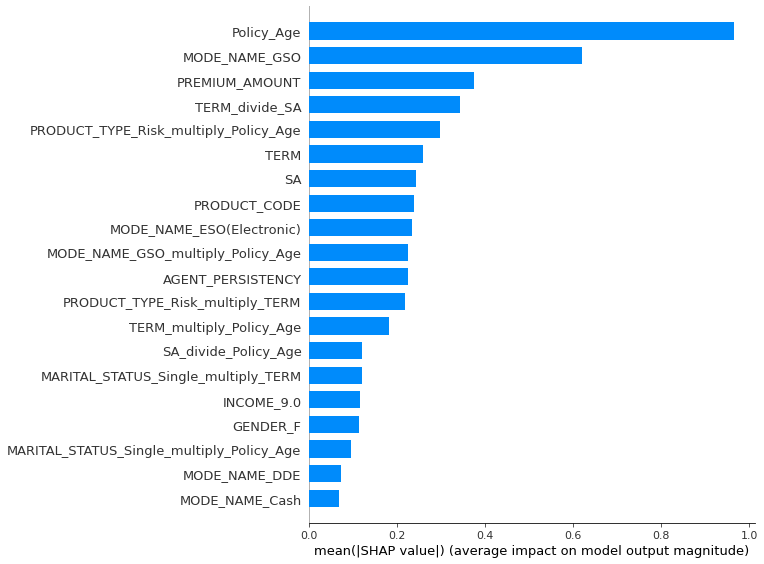

In [40]:
import shap
features_train=get_config('X_train')

shap_values = shap.TreeExplainer(xgboost).shap_values(features_train)
shap.summary_plot(shap_values, features_train, plot_type="bar")

In [46]:
import lime
from lime import lime_tabular

explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(features_train),            #Trainin data from % split
    feature_names=features_train.columns,              #collumns names from the data
    class_names=['inforce', 'Lapse'],           #Distinct classes from the target class
    mode='classification'
)

In [48]:
explainer = shap.TreeExplainer(xgboost)

In [ ]:
pipeline.

In [55]:
pipeline=d
obj = [d, features_selected, xgboost, explainer]
import pickle
with open('score_objects.pkl', 'wb') as handle:
    pickle.dump(obj, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [56]:
model = load_model('deployment_28042020')

2021-10-05 08:17:04,397 - INFO     - Initializing load_model()
2021-10-05 08:17:04,397 - INFO     - load_model(model_name=deployment_28042020, platform=None, authentication=None, verbose=True)


Transformation Pipeline and Model Successfully Loaded


In [82]:
df=pd.read_csv('treyyyyy.csv')
df.drop(['Unnamed: 0'],axis=1,inplace=True)

In [83]:
df.columns

Index(['AGENT_PERSISTENCY', 'GENDER', 'INCOME', 'MARITAL_STATUS', 'MODE_NAME',
       'PREMIUM_AMOUNT', 'PREMIUM_FREQUENCY', 'PREMIUM_STATUS', 'PRODUCT_CODE',
       'PRODUCT_TYPE', 'Policy_Age', 'Policy_holder_Age', 'SA',
       'SALES_CHANNEL', 'TERM', 'EDUCATION', 'STATUS_NAME'],
      dtype='object')

In [86]:
pipeline.transform(df)

KeyError: "None of [Index(['Policy_holder_Age', 'INCOME'], dtype='object')] are in the [columns]"

In [25]:

# save transformation pipeline and model 
save_model(xgboost, model_name = 'deployment_28042020')

Initializing save_model()
save_model(model=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0), model_name=deployment_28042020, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                     

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[],
                                       target='STATUS_NAME', time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='most frequent',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_s...
                                learning_rate=0.300000012, max_delta_step=0,
                                max_depth=6, min_child_weight=1, missing=nan,
                                monotone_constraints='()', n_estimators=100,
                                n_jobs=-1

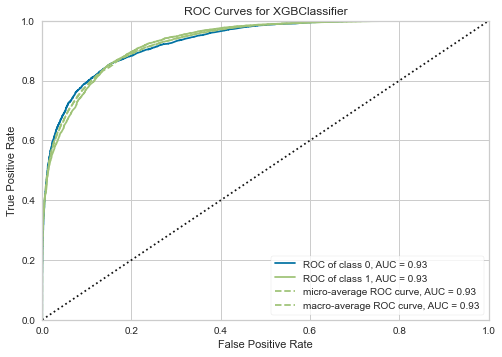

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [100]:
plot_model(xgboost,plot='auc')

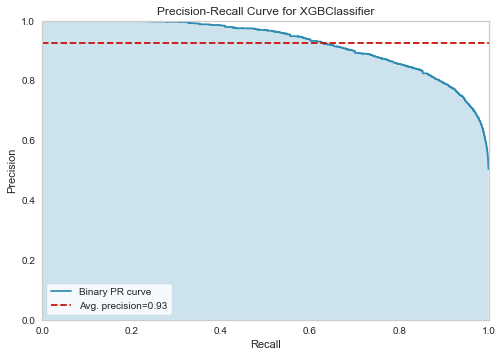

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [101]:
plot_model(xgboost,plot='pr')

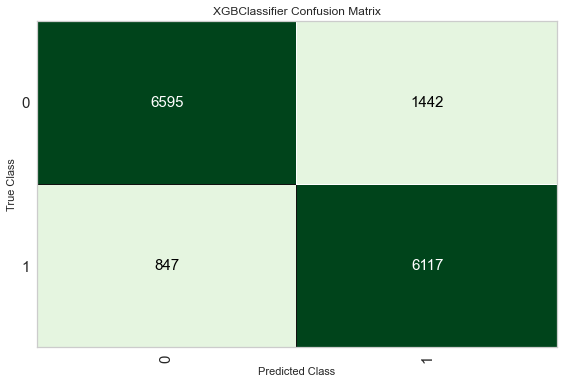

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [102]:
plot_model(xgboost,plot='confusion_matrix')

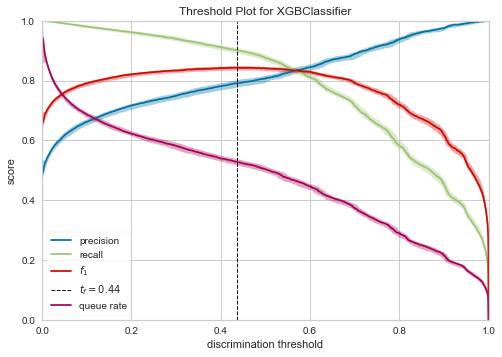

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [103]:
plot_model(xgboost,plot='threshold')

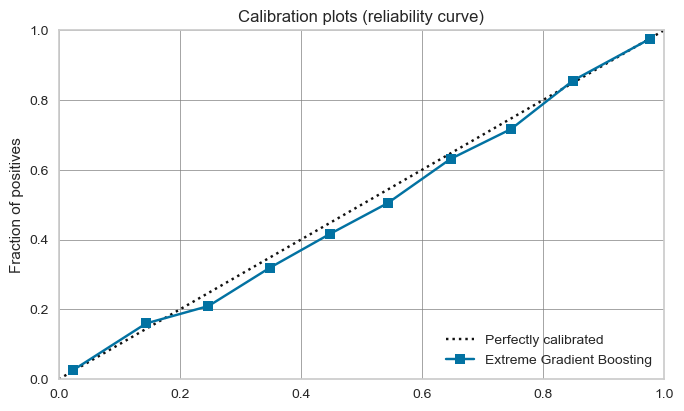

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [104]:
plot_model(xgboost,plot='calibration')

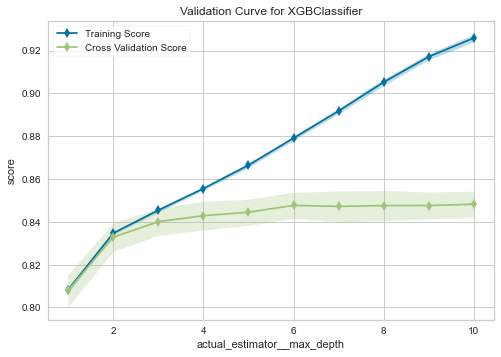

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [105]:
plot_model(xgboost,plot='vc')

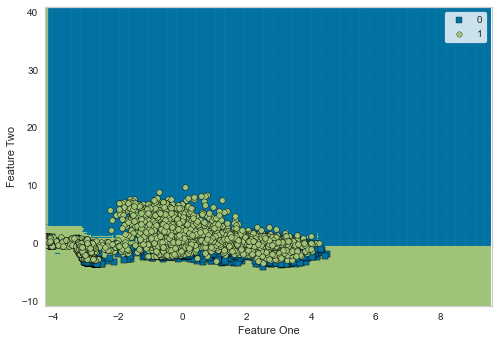

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [106]:
plot_model(xgboost,plot='boundary')

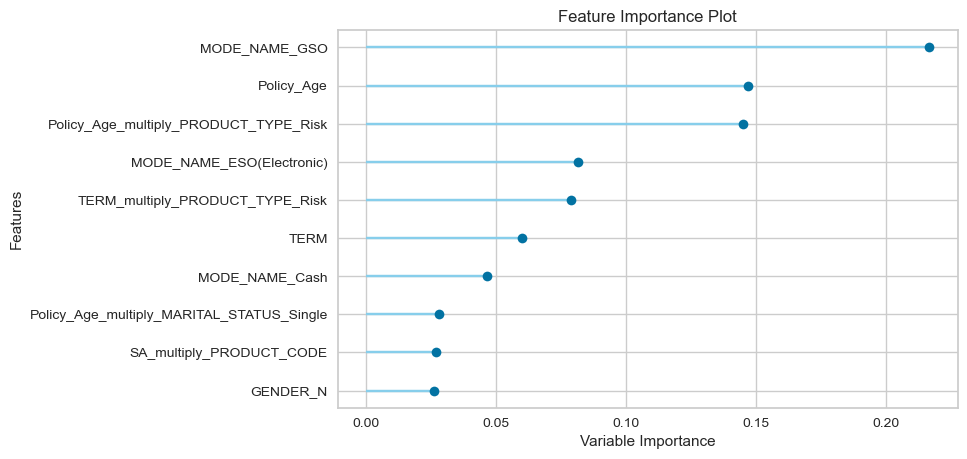

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [107]:
plot_model(xgboost,plot='feature')

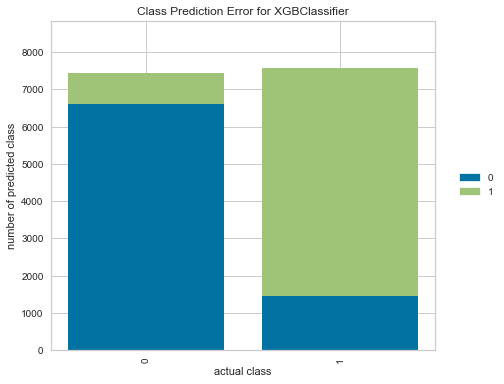

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [108]:
plot_model(xgboost,plot='error')

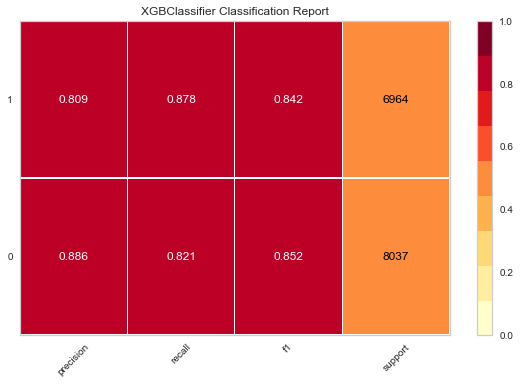

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [109]:
plot_model(xgboost,plot='class_report')

# Tree Visualisation

In [ ]:
import matplotlib.pyplot as plt
import graphviz
from xgboost import plot_tree
plot_tree(xgboost)
plt.show()

In [ ]:
import graphviz

In [ ]:
node_params={'shape':'box','style':'filled,rounded','fillcolor':'#78cbe'}
leaf_params={'shape':'box','style':'filled,rounded','fillcolor':'#e48038'}

In [ ]:
import xgboost as xgb

In [ ]:
xgb.to_graphviz(xgboost,num_trees=0 ,size='2,2',condition_node_params=node_params,leaf_node_params=leaf_params)

In [ ]:
graph_data=xgb.to_graphviz(xgboost,num_trees=0 ,size='1,1',condition_node_params=node_params,leaf_node_params=leaf_params)
graph_data.view(filename='lapse_tree')

The following link will help you with the hyperparameter
https://lightgbm.readthedocs.io/en/latest/Parameters.html

Advantages of mcc over other measures
https://bmcgenomics.biomedcentral.com/track/pdf/10.1186/s12864-019-6413-7.pdf

# Calibration

https://www.unofficialgoogledatascience.com/2021/04/why-model-calibration-matters-and-how.html

# Tune Model  Custom

#Try tuning for max depth and number of leaves

light
params_test1={
    'max_depth': [6,7,8],
    'num_leaves':range(50, 170, 30),
    'feature_fraction': [0.5, 0.6, 0.7, 0.8, 0.9],
    'bagging_fraction': [0.6, 0.7, 0.8, 0.9, 1.0],
    'min_child_samples': [18, 19, 20, 21, 22],
    'min_child_weight':[0.001, 0.002],
    'reg_alpha': [0, 0.001, 0.01, 0.03, 0.08, 0.3, 0.5],
    'reg_lambda': [0, 0.001, 0.01, 0.03, 0.08, 0.3, 0.5]
}

In [111]:
params = {'learning_rate': [0.1,0.25, 1],
                'max_depth':[3,4,5], 'gamma': [0,0.25, 1],'reg_lamda':[0,1,10],'scale_pos_weight':[1,3,5]}

In [ ]:
tuned_xgboost=tune_model(xgboost,custom_grid=params,n_iter=50)

In [ ]:
plot_model(tuned_xgboost,'parameter')

In [118]:
tuned_xgboost_bayesian=tune_model(xgboost,custom_grid=params,n_iter=50,search_library='scikit-optimize',round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.86,0.93,0.87,0.82,0.85,0.71,0.71,5265000.00
1,0.85,0.94,0.88,0.82,0.85,0.70,0.70,5407000.00
2,0.83,0.92,0.87,0.79,0.83,0.67,0.67,5256000.00
3,0.83,0.93,0.87,0.80,0.83,0.67,0.67,5349000.00
4,0.84,0.93,0.89,0.78,0.83,0.68,0.68,5286000.00
5,0.85,0.93,0.88,0.81,0.84,0.70,0.70,5246000.00
6,0.84,0.93,0.86,0.81,0.84,0.69,0.69,5331000.00
7,0.85,0.94,0.89,0.81,0.85,0.71,0.71,5384000.00
8,0.84,0.93,0.89,0.79,0.84,0.69,0.69,5296000.00
9,0.85,0.93,0.87,0.82,0.84,0.70,0.70,5446000.00


create_model_container: 34
master_model_container: 34
display_container: 10
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0.25, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.25, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, reg_lamda=0, scale_pos_weight=1, subsample=1,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0)
tune_model() succesfully completed......................................


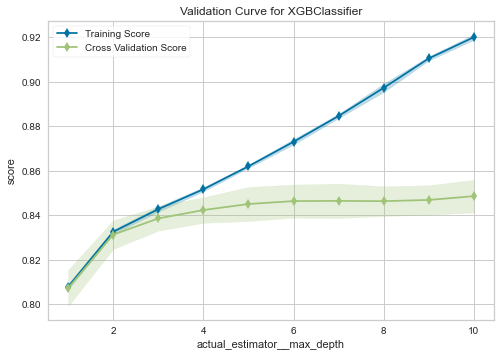

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [120]:
plot_model(tuned_xgboost_bayesian,'vc')

In [22]:
XGBoost_recall=tune_model(xgboost,search_library='scikit-optimize',optimize='f1',round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.83,0.92,0.90,0.77,0.83,0.67,0.67
1,0.83,0.93,0.91,0.77,0.83,0.66,0.67
2,0.81,0.92,0.90,0.75,0.82,0.63,0.64
3,0.82,0.92,0.91,0.75,0.82,0.64,0.65
4,0.82,0.92,0.92,0.74,0.82,0.64,0.65
5,0.83,0.92,0.91,0.76,0.83,0.66,0.68
6,0.83,0.92,0.90,0.77,0.83,0.66,0.67
7,0.84,0.93,0.92,0.78,0.84,0.68,0.69
8,0.82,0.92,0.91,0.74,0.82,0.64,0.65
9,0.83,0.92,0.91,0.77,0.83,0.66,0.67


2021-09-20 11:06:06,901 - INFO     - create_model_container: 2
2021-09-20 11:06:06,902 - INFO     - master_model_container: 2
2021-09-20 11:06:06,902 - INFO     - display_container: 3
2021-09-20 11:06:06,905 - INFO     - XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.6666385664760582, gamma=0,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=3.666594609192015e-05, max_delta_step=0,
              max_depth=10, min_child_weight=3, missing=nan,
              monotone_constraints='()', n_estimators=275, n_jobs=-1,
              num_parallel_tree=1, objective='binary:logistic',
              random_state=8755, reg_alpha=0.04987547337654676,
              reg_lambda=0.03063785771757559,
              scale_pos_weight=1.4450619343631605, subsample=0.9659203157475014,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              ver

In [23]:
#Save the Recall tuned model.


# save transformation pipeline and model 
save_model(XGBoost_recall, model_name = 'XGBoost_recall')





2021-09-20 11:08:14,844 - INFO     - Initializing save_model()
2021-09-20 11:08:14,845 - INFO     - save_model(model=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.6666385664760582, gamma=0,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=3.666594609192015e-05, max_delta_step=0,
              max_depth=10, min_child_weight=3, missing=nan,
              monotone_constraints='()', n_estimators=275, n_jobs=-1,
              num_parallel_tree=1, objective='binary:logistic',
              random_state=8755, reg_alpha=0.04987547337654676,
              reg_lambda=0.03063785771757559,
              scale_pos_weight=1.4450619343631605, subsample=0.9659203157475014,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), model_name=XGBoost_recall, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
      

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[],
                                       target='STATUS_NAME', time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='most frequent',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_s...
                                min_child_weight=3, missing=nan,
                                monotone_constraints='()', n_estimators=275,
                                n_jobs=-1, num_parallel_tree=1,
                                objective='binary:logistic', random

Executing shutdown due to inactivity...


2021-09-20 11:50:43,773 - INFO     - Executing shutdown due to inactivity...


Executing shutdown...


2021-09-20 11:50:47,830 - INFO     - Executing shutdown...


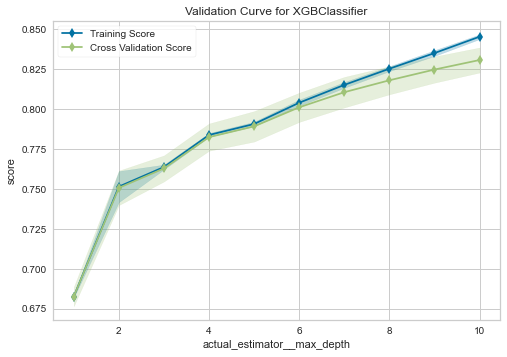

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [124]:
plot_model(XGBoost_recall,'vc')

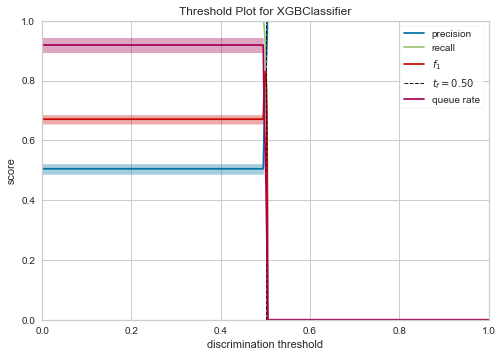

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [126]:
plot_model(XGBoost_recall,plot='threshold')

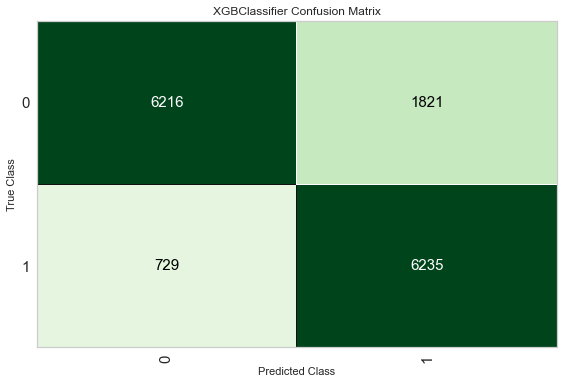

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [128]:
plot_model(XGBoost_recall,plot='confusion_matrix')

In [ ]:
plot_model(XGBoost_recall,'parameter',save=True)

In [ ]:
#evaluate the optimised mode
evaluate_model(XGBoost_recall)

In [ ]:
predict_model(tuned_xgboost_bayesian)

In [ ]:
#Check for overfiiting  or You can diagnose the calibration of a classifier
#Below the diagonal: The model has over-forecast; the probabilities are too large.
#Above the diagonal: The model has under-forecast; the probabilities are too small.
# more info at https://machinelearningmastery.com/calibrated-classification-model-in-scikit-learn/
plot_model(light,plot='calibration')

# Model Explaining

In [25]:
#Get X_test data from enviroment
X_test=get_config('X_test')

2021-09-21 10:46:56,435 - INFO     - Initializing get_config()
2021-09-21 10:46:56,435 - INFO     - get_config(variable=X_test)
2021-09-21 10:46:56,459 - INFO     - Global variable: X_test returned as         Policy_Age  PREMIUM_AMOUNT  MODE_NAME_Electronic Cash Collection  \
398804   -0.617459        0.111979                                   0.0   
412728   -0.617459        0.002791                                   0.0   
484888   -1.385807        2.373087                                   0.0   
671755    0.468417       -0.663340                                   1.0   
559396    0.468417       -1.215344                                   1.0   
...            ...             ...                                   ...   
410994   -0.617459        0.304179                                   0.0   
258875    0.468417       -0.868684                                   0.0   
373459   -0.244930       -0.210140                                   0.0   
614554    0.117305       -1.307469     

In [20]:
X_train=get_config('X_train')
X_train.to_csv('X_train'
          , index = False, header = True)

2021-09-21 10:29:36,706 - INFO     - Initializing get_config()
2021-09-21 10:29:36,706 - INFO     - get_config(variable=X_train)
2021-09-21 10:29:36,714 - INFO     - Global variable: X_train returned as         Policy_Age  PREMIUM_AMOUNT  MODE_NAME_Electronic Cash Collection  \
581434    0.468417       -1.037752                                   1.0   
343443   -0.244930        0.440681                                   0.0   
326250    0.117305       -0.106499                                   0.0   
384537   -0.617459       -0.106499                                   0.0   
509408   -0.244930       -1.215344                                   1.0   
...            ...             ...                                   ...   
565974    0.468417       -1.307469                                   1.0   
63660     5.195447       -0.539129                                   0.0   
104550    1.802972        0.286264                                   0.0   
445004   -0.998204        0.149356   

In [31]:
y_test =get_config('y_test')

Initializing get_config()
get_config(variable=y_test)
Global variable: y_test returned as 398804    0
412728    0
484888    0
671755    1
559396    1
         ..
410994    0
258875    1
373459    1
614554    0
672371    1
Name: STATUS_NAME, Length: 15001, dtype: int64
get_config() succesfully completed......................................


In [21]:
y_train =get_config('y_train')
y_train.to_csv('y_train'
          , index = False, header = True)

2021-09-21 10:30:33,567 - INFO     - Initializing get_config()
2021-09-21 10:30:33,575 - INFO     - get_config(variable=y_train)
2021-09-21 10:30:33,577 - INFO     - Global variable: y_train returned as 581434    1
343443    0
326250    1
384537    1
509408    1
         ..
565974    1
63660     1
104550    1
445004    0
205657    0
Name: STATUS_NAME, Length: 34999, dtype: int32
2021-09-21 10:30:33,577 - INFO     - get_config() succesfully completed......................................


In [33]:
y_test

398804    0
412728    0
484888    0
671755    1
559396    1
         ..
410994    0
258875    1
373459    1
614554    0
672371    1
Name: STATUS_NAME, Length: 15001, dtype: int64

In [34]:
#get y_test
y_test=get_config('y_test')
y_test.iloc[54]

Initializing get_config()
get_config(variable=y_test)
Global variable: y_test returned as 398804    0
412728    0
484888    0
671755    1
559396    1
         ..
410994    0
258875    1
373459    1
614554    0
672371    1
Name: STATUS_NAME, Length: 15001, dtype: int64
get_config() succesfully completed......................................


0

In [28]:
data=X_test.iloc[8]
type(data)

pandas.core.series.Series

Executing shutdown due to inactivity...


2021-09-21 11:05:02,496 - INFO     - Executing shutdown due to inactivity...


Executing shutdown...


2021-09-21 11:05:06,540 - INFO     - Executing shutdown...


In [214]:
predictions = predict_model(xgboost)
#Get the correct predictions
predictions.loc[(predictions['STATUS_NAME'] == predictions['Label'])]

Initializing predict_model()
predict_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,Extreme Gradient Boosting,0.8474,0.9331,0.8784,0.8092,0.8424,0.6950,0.6972,23026000


,MODE_NAME_ESO(Electronic),PRODUCT_TYPE_Risk,TERM,INCOME_9.0,SALES_CHANNEL_Broker,AGENT_PERSISTENCY,MARITAL_STATUS_Single,MODE_NAME_Electronic Cash Collection,PRODUCT_CODE,Policy_Age,...,Policy_Age_multiply_TERM,TERM_multiply_PRODUCT_TYPE_Risk,Policy_Age_multiply_PRODUCT_TYPE_Risk,TERM_divide_SA,SA_divide_Policy_Age,Policy_Age_multiply_MARITAL_STATUS_Single,SA_multiply_PRODUCT_CODE,STATUS_NAME,Label,Score
1,0.0,1.0,0.783671,0.0,1.0,-0.099778,0.0,0.0,1.214314,-0.617459,...,-0.483884,0.783671,-0.617459,7.148010,-0.177558,-0.000000,0.133131,Inforce,Inforce,0.9653
2,0.0,1.0,0.783135,1.0,1.0,1.384446,0.0,0.0,-1.357581,-1.385807,...,-1.085274,0.783135,-1.385807,0.258930,-2.182490,-0.000000,-4.106016,Inforce,Inforce,0.9008
3,0.0,1.0,0.785815,1.0,0.0,-1.403001,1.0,1.0,1.214314,0.468417,...,0.368089,0.785815,0.468417,-1.374171,-1.220807,0.468417,-0.694402,Lapsed,Lapsed,0.6415
4,0.0,1.0,0.785279,1.0,0.0,-1.403001,1.0,1.0,0.023807,0.468417,...,0.367838,0.785279,0.468417,9.203206,0.182160,0.468417,0.002031,Lapsed,Lapsed,0.9031
5,0.0,1.0,-1.273270,0.0,0.0,-1.403001,1.0,0.0,-0.784016,1.477206,...,-1.880881,-1.273270,1.477206,-0.442248,1.949006,1.477206,-2.257249,Lapsed,Lapsed,0.9991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,0.0,1.0,0.784207,0.0,0.0,0.014999,1.0,0.0,1.214314,-0.617459,...,-0.484215,0.784207,-0.617459,0.980456,-1.295373,-0.617459,0.971256,Lapsed,Lapsed,0.5501
14996,1.0,0.0,-1.273270,0.0,1.0,0.560983,1.0,0.0,-0.761531,-0.617459,...,0.786191,-0.000000,-0.000000,1.510066,1.365578,-0.617459,0.642114,Inforce,Inforce,0.9925
14997,0.0,0.0,-1.273920,0.0,1.0,1.363712,0.0,0.0,-0.784016,0.468417,...,-0.596726,-0.000000,0.000000,1.510837,-1.800080,0.000000,0.661073,Lapsed,Lapsed,0.9571
14998,0.0,1.0,0.784207,0.0,0.0,0.061228,1.0,0.0,1.214314,-0.244930,...,-0.192076,0.784207,-0.244930,2.273484,-1.408304,-0.244930,0.418861,Lapsed,Lapsed,0.7739


In [177]:
predictions = predict_model(XGBoost_recall)
#Get the correct classifications
predictions.loc[(predictions['STATUS_NAME'] == predictions['Label'])]

Initializing predict_model()
predict_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.6666385664760582, gamma=0,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=3.666594609192015e-05, max_delta_step=0,
              max_depth=10, min_child_weight=3, missing=nan,
              monotone_constraints='()', n_estimators=275, n_jobs=-1,
              num_parallel_tree=1, objective='binary:logistic',
              random_state=8755, reg_alpha=0.04987547337654676,
              reg_lambda=0.03063785771757559,
              scale_pos_weight=1.4450619343631605, subsample=0.9659203157475014,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking excepti

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,Extreme Gradient Boosting,0.8300,0.9213,0.8953,0.7740,0.8302,0.6618,0.6689,23119000


,MODE_NAME_ESO(Electronic),PRODUCT_TYPE_Risk,TERM,INCOME_9.0,SALES_CHANNEL_Broker,AGENT_PERSISTENCY,MARITAL_STATUS_Single,MODE_NAME_Electronic Cash Collection,PRODUCT_CODE,Policy_Age,...,Policy_Age_multiply_TERM,TERM_multiply_PRODUCT_TYPE_Risk,Policy_Age_multiply_PRODUCT_TYPE_Risk,TERM_divide_SA,SA_divide_Policy_Age,Policy_Age_multiply_MARITAL_STATUS_Single,SA_multiply_PRODUCT_CODE,STATUS_NAME,Label,Score
1,0.0,1.0,0.783671,0.0,1.0,-0.099778,0.0,0.0,1.214314,-0.617459,...,-0.483884,0.783671,-0.617459,7.148010,-0.177558,-0.000000,0.133131,Inforce,Inforce,0.5028
2,0.0,1.0,0.783135,1.0,1.0,1.384446,0.0,0.0,-1.357581,-1.385807,...,-1.085274,0.783135,-1.385807,0.258930,-2.182490,-0.000000,-4.106016,Inforce,Inforce,0.5036
3,0.0,1.0,0.785815,1.0,0.0,-1.403001,1.0,1.0,1.214314,0.468417,...,0.368089,0.785815,0.468417,-1.374171,-1.220807,0.468417,-0.694402,Lapsed,Lapsed,0.5035
4,0.0,1.0,0.785279,1.0,0.0,-1.403001,1.0,1.0,0.023807,0.468417,...,0.367838,0.785279,0.468417,9.203206,0.182160,0.468417,0.002031,Lapsed,Lapsed,0.5041
5,0.0,1.0,-1.273270,0.0,0.0,-1.403001,1.0,0.0,-0.784016,1.477206,...,-1.880881,-1.273270,1.477206,-0.442248,1.949006,1.477206,-2.257249,Lapsed,Lapsed,0.5049
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,0.0,1.0,0.784207,0.0,0.0,0.014999,1.0,0.0,1.214314,-0.617459,...,-0.484215,0.784207,-0.617459,0.980456,-1.295373,-0.617459,0.971256,Lapsed,Lapsed,0.5019
14996,1.0,0.0,-1.273270,0.0,1.0,0.560983,1.0,0.0,-0.761531,-0.617459,...,0.786191,-0.000000,-0.000000,1.510066,1.365578,-0.617459,0.642114,Inforce,Inforce,0.5037
14997,0.0,0.0,-1.273920,0.0,1.0,1.363712,0.0,0.0,-0.784016,0.468417,...,-0.596726,-0.000000,0.000000,1.510837,-1.800080,0.000000,0.661073,Lapsed,Lapsed,0.5042
14998,0.0,1.0,0.784207,0.0,0.0,0.061228,1.0,0.0,1.214314,-0.244930,...,-0.192076,0.784207,-0.244930,2.273484,-1.408304,-0.244930,0.418861,Lapsed,Lapsed,0.5012


In [30]:

import lime
from lime import lime_tabular

explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),            #Trainin data from % split
    feature_names=X_train.columns,              #collumns names from the data
    class_names=['inforce', 'Lapse'],           #Distinct classes from the target class
    mode='classification'
)

In [23]:
#Visual of the outcome
number11=X_test.iloc[11]

NameError: name 'X_test' is not defined

In [31]:
#None tuned xgboost
exp = explainer.explain_instance(
    data_row=X_test.iloc[5],      #Data row is a single observation from the data set
    predict_fn=xgboost.predict_proba,  #Making predictions
    num_features=5
)

exp.show_in_notebook(show_table=True,show_predicted_value=False,predict_proba=True)  #Visualise the prediction interpretation

NameError: name 'xgboost' is not defined

In [217]:
exp.predict_proba

array([8.6152554e-04, 9.9913847e-01], dtype=float32)

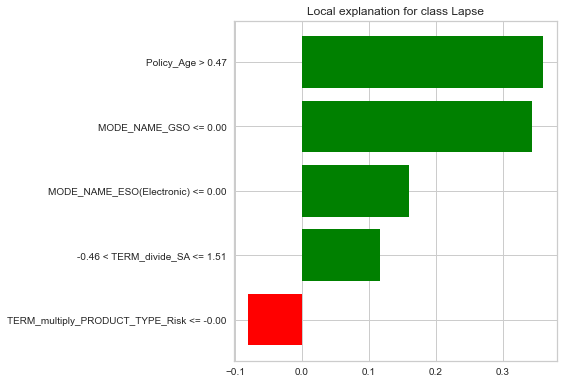

In [218]:
plt=exp.as_pyplot_figure()
plt.tight_layout()

In [219]:
#Tuned Xgboost results
exp = explainer.explain_instance(
    data_row=X_test.iloc[5],      #Data row is a single observation from the data set
    predict_fn=XGBoost_recall.predict_proba,  #Making predictions
    num_features=5
)

exp.show_in_notebook(show_table=True,show_predicted_value=True) 

In [207]:
exp.as_list()

[('Policy_Age > 0.47', 0.0023771054902416685),
 ('MODE_NAME_GSO <= 0.00', 0.001992129539195177),
 ('MODE_NAME_ESO(Electronic) <= 0.00', 0.0008910559743519328),
 ('AGENT_PERSISTENCY <= -1.40', 0.0005437262995203459),
 ('TERM_multiply_PRODUCT_TYPE_Risk <= -0.00', -0.0005390412668061415)]

In [208]:
exp.local_pred  #This is the lapse prediction

array([0.50297056])

In [209]:
exp.class_names

['inforce', 'Lapse']

In [220]:
#The probabilities [0(inforce),1(lapse)]
exp.predict_proba

array([0.49508816, 0.50491184], dtype=float32)

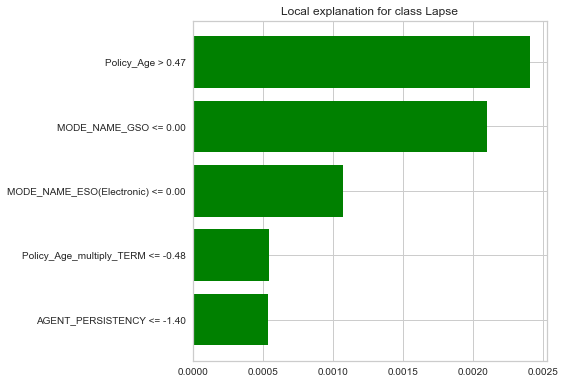

In [221]:
plt=exp.as_pyplot_figure()
plt.tight_layout()
# negative correlation are in red, postive correlations are in green

https://shap.readthedocs.io/en/latest/example_notebooks/tabular_examples/tree_based_models/Catboost%20tutorial.html

In [222]:
interpret_model(xgboost,plot='reason',observation =5)

Initializing interpret_model()
interpret_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0), use_train_data=False, X_new_sample=None, feature=None, kwargs={}, observation=5, plot=reason, save=False)
Checking exceptions
plot type: reason
model type detected: type 2
Creating TreeExplainer
Compiling shap values


Visual Rendered Successfully
interpret_model() succesfully completed......................................


In [ ]:
#wrong prediction
exp = explainer.explain_instance(
    data_row=X_test.iloc[9],      #Data row is a single observation from the data set
    predict_fn=xgboost.predict_proba,  #Making predictions
    num_features=5
)

exp.show_in_notebook(show_table=True,show_predicted_value=True)  #Visualise the prediction interpretation

In [78]:
#Visual of the outcome
y_test.iloc[9]

1

In [77]:
#Please see links
  #   https://www.youtube.com/watch?v=jhopjN08lTM
# https://www.youtube.com/watch?v=CV9FTCvQ32Q
 interpret_model(xgboost2,plot='reason',observation =9)

In [49]:
type(interpret_model(xgboost,plot='summary',save=True))

2021-10-04 16:12:09,053 - INFO     - Initializing interpret_model()
2021-10-04 16:12:09,055 - INFO     - interpret_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0), use_train_data=False, X_new_sample=None, y_new_sample=None, feature=None, kwargs={}, observation=None, plot=summary, save=True)
2021-10-04 16:12:09,056 - INFO     - Checking exceptions
2021-10-04 16:12:09,061 - INFO    

NoneType

In [ ]:
#manual tune
gridParams = {
    'learning_rate': [0.1,0.5,0.7],
    'n_estimators': [20,40,50],
    'num_leaves': [6,8,12,16],
    'boosting_type' : ['gbdt','goss'],
    'objective' : ['binary'],
    'random_state' : [5], # Updated from 'seed'
    'colsample_bytree' : [0.65, 0.66],
    'subsample' : [0.7,0.75],
    'reg_alpha' : [1,1.2],
    'reg_lambda' : [1,1.2,1.4],
    }

In [ ]:
X=get_config('X')
y=get_config('y')

# Light Gradient Boosting Machine

In [21]:
lightgbm=create_model('lightgbm',round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.85,0.93,0.87,0.82,0.84,0.70,0.71,5241000.00
1,0.85,0.94,0.88,0.82,0.85,0.70,0.70,5409000.00
2,0.84,0.92,0.87,0.80,0.83,0.67,0.67,5256000.00
3,0.83,0.93,0.87,0.80,0.83,0.67,0.67,5338000.00
4,0.84,0.93,0.89,0.78,0.83,0.68,0.68,5285000.00
5,0.84,0.93,0.87,0.79,0.83,0.68,0.68,5181000.00
6,0.85,0.93,0.87,0.82,0.84,0.69,0.70,5357000.00
7,0.85,0.93,0.88,0.81,0.84,0.70,0.70,5305000.00
8,0.84,0.93,0.88,0.79,0.83,0.68,0.69,5250000.00
9,0.84,0.93,0.87,0.82,0.84,0.69,0.69,5405000.00


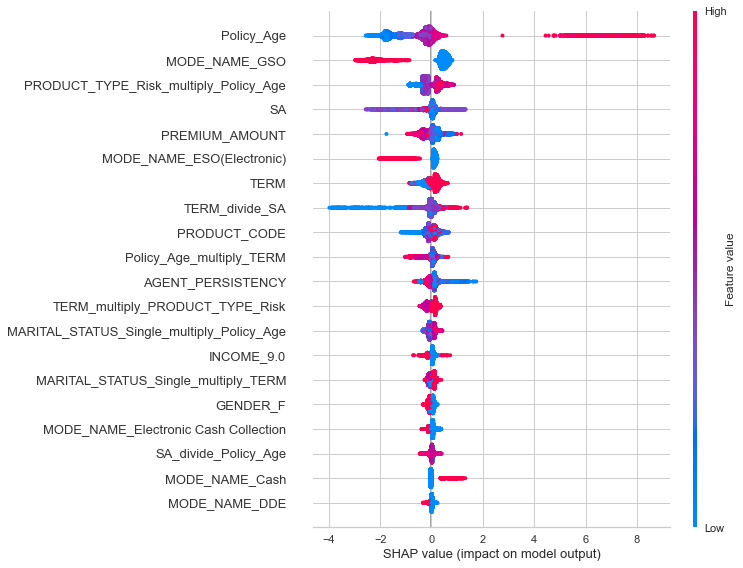

In [56]:
interpret_model(lightgbm)

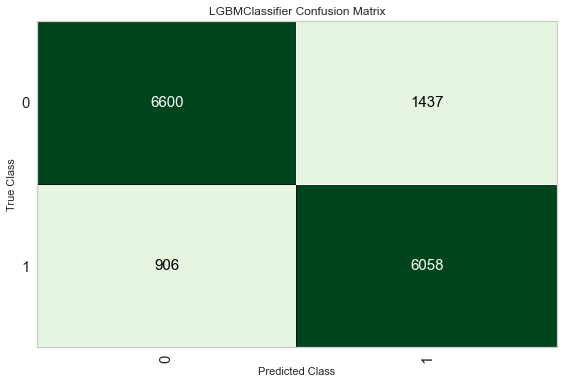

In [51]:
plot_model(lightgbm,plot='confusion_matrix')

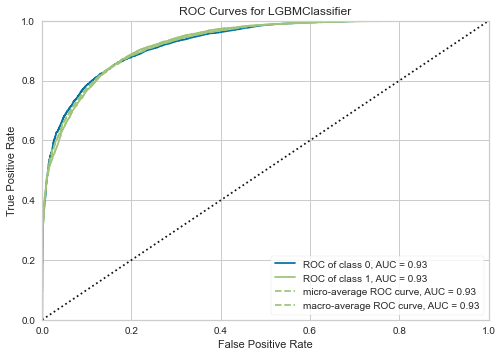

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [228]:
plot_model(lightgbm,plot='auc')

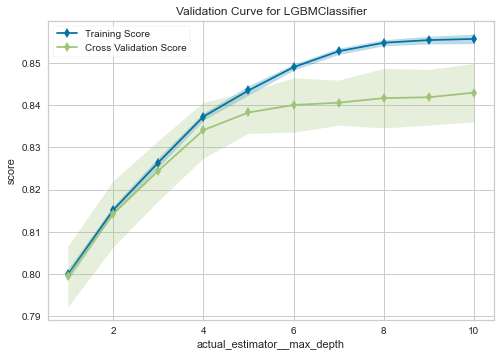

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [229]:
plot_model(lightgbm,plot='vc')

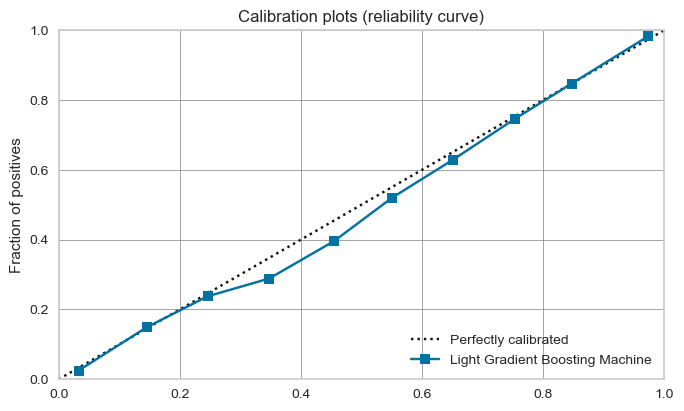

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [230]:
plot_model(lightgbm,plot='calibration')

In [30]:
#How does caliberating te model help
Caliberated_Light_Gradient_boosting=calibrate_model(lightgbm,method='sigmoid')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.8506,0.9332,0.8608,0.8202,0.8400,0.7000,0.7007,5191000.0000
1,0.8511,0.9383,0.8654,0.8246,0.8445,0.7019,0.7027,5359000.0000
2,0.8394,0.9266,0.8526,0.8106,0.8310,0.6782,0.6790,5205000.0000
3,0.8389,0.9310,0.8596,0.8094,0.8337,0.6777,0.6788,5323000.0000
4,0.8383,0.9307,0.8730,0.7935,0.8313,0.6767,0.6795,5217000.0000
5,0.8503,0.9342,0.8637,0.8163,0.8394,0.6994,0.7004,5168000.0000
6,0.8477,0.9272,0.8638,0.8202,0.8414,0.6951,0.6960,5346000.0000
7,0.8529,0.9372,0.8716,0.8190,0.8445,0.7051,0.7063,5283000.0000
8,0.8457,0.9315,0.8657,0.8089,0.8364,0.6907,0.6922,5194000.0000
9,0.8445,0.9307,0.8565,0.8217,0.8388,0.6888,0.6893,5353000.0000


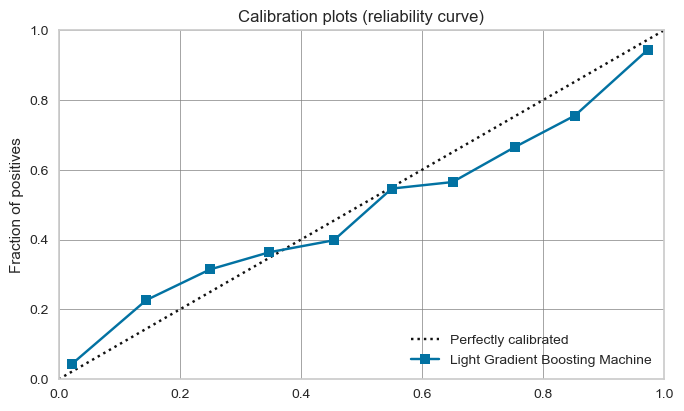

In [32]:
plot_model(Caliberated_Light_Gradient_boosting,plot='calibration')

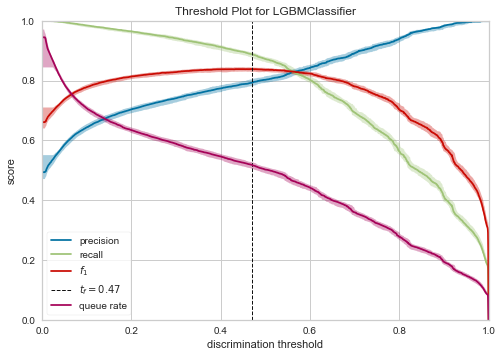

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [231]:
plot_model(lightgbm,plot='threshold')

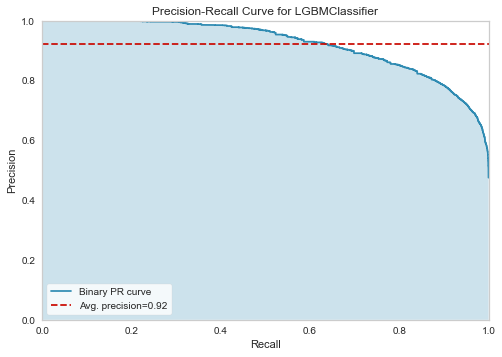

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [232]:
plot_model(lightgbm,plot='pr')

In [67]:
plot_model(lightgbm,plot='parameter')

,Parameters
boosting_type,gbdt
class_weight,None
colsample_bytree,1.0
importance_type,split
learning_rate,0.1
max_depth,-1
min_child_samples,20
min_child_weight,0.001
min_split_gain,0.0
n_estimators,100


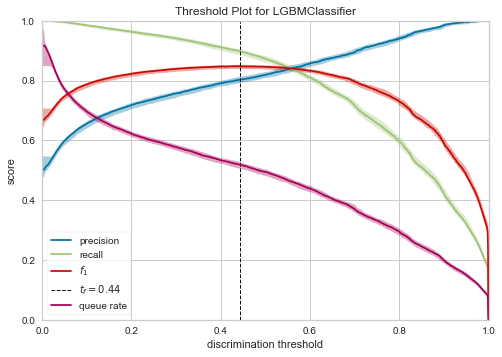

In [36]:
plot_model(lightgbm,plot='threshold')

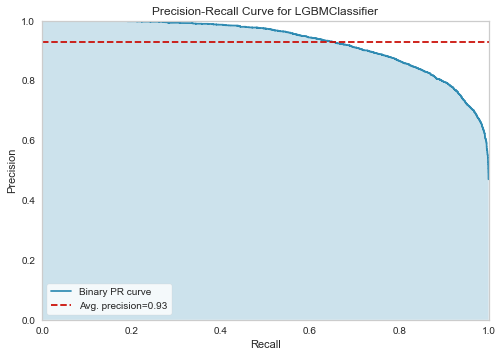

In [37]:
plot_model(lightgbm,plot='pr')

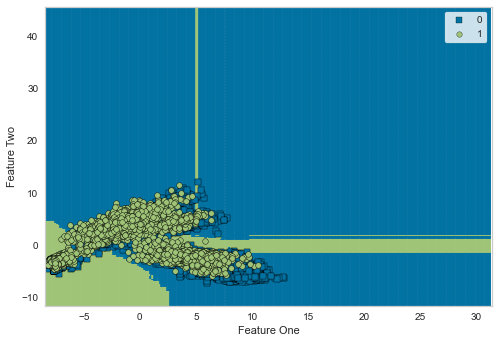

In [38]:
plot_model(lightgbm,plot='boundary')

In [ ]:
#Tuning

In [265]:

#manual tune
gridParams = {
    'learning_rate': [0.1,0.5,0.7],
    'n_estimators': range(0,100),
    'num_leaves': [6,8,12,16],
    'max_depth' :[1,2,4,5,7,10],
    'boosting_type' : ['gbdt','goss'],
    'objective' : ['binary'],
    'random_state' : [8755], # Updated from 'seed'
    'colsample_bytree' : [0.65, 0.66],
    'subsample' : [0.7,0.75],
    'reg_alpha' : [1,1.2],
    'reg_lambda' : [1,1.2,1.4],
    }

In [267]:
tuned_light_OPTUNA=tune_model(lightgbm,search_library='optuna',search_algorithm='tpe',optimize='recall')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.8480,0.9296,0.8596,0.8166,0.8375,0.6949,0.6957,5176000.0000
1,0.8529,0.9352,0.8758,0.8211,0.8476,0.7056,0.7070,5416000.0000
2,0.8331,0.9205,0.8618,0.7951,0.8271,0.6664,0.6684,5228000.0000
3,0.8343,0.9262,0.8669,0.7980,0.8310,0.6690,0.6712,5343000.0000
4,0.8437,0.9286,0.8805,0.7981,0.8373,0.6876,0.6907,5272000.0000
5,0.8454,0.9319,0.8757,0.8014,0.8369,0.6906,0.6930,5208000.0000
6,0.8406,0.9219,0.8571,0.8124,0.8341,0.6809,0.6818,5288000.0000
7,0.8514,0.9333,0.8741,0.8151,0.8436,0.7024,0.7040,5290000.0000
8,0.8323,0.9278,0.8651,0.7875,0.8245,0.6646,0.6673,5144000.0000
9,0.8514,0.9293,0.8765,0.8209,0.8478,0.7029,0.7044,5476000.0000


create_model_container: 76
master_model_container: 76
display_container: 35
LGBMClassifier(bagging_fraction=0.9012560821875191, bagging_freq=5,
               boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               feature_fraction=0.6182198845832182, importance_type='split',
               learning_rate=0.43788217135996976, max_depth=-1,
               min_child_samples=58, min_child_weight=0.001,
               min_split_gain=0.323797545836921, n_estimators=106, n_jobs=-1,
               num_leaves=157, objective=None, random_state=8755,
               reg_alpha=0.0007778964206841563, reg_lambda=1.3106048235556393,
               silent=True, subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0)
tune_model() succesfully completed......................................


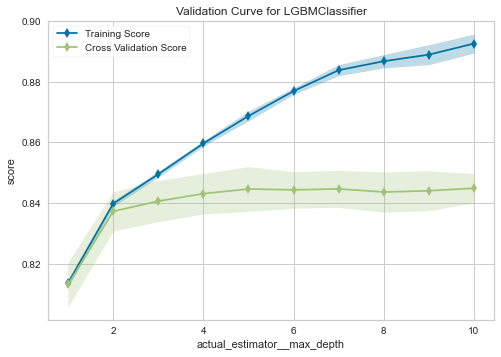

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [269]:
plot_model(tuned_light_OPTUNA,'vc')

In [288]:
#Custom grid
tuned_light_OPTUNA1=tune_model(lightgbm,custom_grid=params,optimize='recall',search_library='scikit-optimize',round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.77,0.93,0.97,0.68,0.80,0.56,0.61,5443000.00
1,0.78,0.93,0.97,0.69,0.80,0.57,0.61,5614000.00
2,0.77,0.92,0.97,0.68,0.80,0.55,0.60,5509000.00
3,0.77,0.92,0.97,0.68,0.80,0.55,0.60,5644000.00
4,0.77,0.92,0.97,0.67,0.79,0.55,0.60,5464000.00
5,0.77,0.93,0.97,0.67,0.80,0.56,0.61,5424000.00
6,0.78,0.92,0.96,0.69,0.81,0.58,0.62,5613000.00
7,0.78,0.93,0.97,0.68,0.80,0.57,0.62,5518000.00
8,0.77,0.92,0.98,0.67,0.80,0.56,0.61,5458000.00
9,0.79,0.92,0.97,0.70,0.81,0.58,0.62,5704000.00


create_model_container: 85
master_model_container: 85
display_container: 44
LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               gamma=0.0, importance_type='split', learning_rate=0.1,
               max_depth=5, min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
               objective=None, random_state=8755, reg_alpha=0.0, reg_lambda=0.0,
               reg_lamda=1, scale_pos_weight=5, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
tune_model() succesfully completed......................................
(pid=None) C:\ProgramData\Anaconda3\lib\site-packages\ray\autoscaler\_private\cli_logger.py:57: FutureWarning: Not all Ray CLI dependencies were found. In Ray 1.4+, the Ray CLI, autoscaler, and dashboard will only be usable via `pip install 'ray[default]'`. Please update your install command.
(pid=None)   warnings.warn(
(pid=None) C

In [26]:
tuned_light_OPTUNA2=tune_model(lightgbm,optimize='F1',search_library='scikit-optimize',round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.86,0.93,0.86,0.83,0.85,0.71,0.71,5221000.00
1,0.85,0.94,0.88,0.82,0.85,0.71,0.71,5421000.00
2,0.84,0.92,0.87,0.80,0.84,0.68,0.68,5294000.00
3,0.83,0.93,0.87,0.80,0.83,0.67,0.67,5360000.00
4,0.85,0.93,0.88,0.80,0.84,0.69,0.70,5305000.00
5,0.85,0.93,0.88,0.81,0.84,0.70,0.70,5219000.00
6,0.84,0.92,0.86,0.81,0.83,0.68,0.68,5296000.00
7,0.86,0.94,0.89,0.82,0.85,0.72,0.72,5388000.00
8,0.84,0.93,0.88,0.80,0.84,0.69,0.69,5249000.00
9,0.85,0.93,0.87,0.82,0.85,0.71,0.71,5473000.00


create_model_container: 2
master_model_container: 2
display_container: 3
LGBMClassifier(bagging_fraction=0.9295090189269537, bagging_freq=2,
               boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               feature_fraction=0.8066047681522839, importance_type='split',
               learning_rate=0.1937324396509947, max_depth=-1,
               min_child_samples=25, min_child_weight=0.001,
               min_split_gain=0.15821707893247786, n_estimators=272, n_jobs=-1,
               num_leaves=171, objective=None, random_state=8755,
               reg_alpha=1.557592620646393, reg_lambda=8.045525719180284e-09,
               silent=True, subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0)
tune_model() succesfully completed......................................


In [293]:
evaluate_model(tuned_light_OPTUNA2)

Initializing evaluate_model()
evaluate_model(estimator=LGBMClassifier(bagging_fraction=0.9295090189269537, bagging_freq=2,
               boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               feature_fraction=0.8066047681522839, importance_type='split',
               learning_rate=0.1937324396509947, max_depth=-1,
               min_child_samples=25, min_child_weight=0.001,
               min_split_gain=0.15821707893247786, n_estimators=272, n_jobs=-1,
               num_leaves=171, objective=None, random_state=8755,
               reg_alpha=1.557592620646393, reg_lambda=8.045525719180284e-09,
               silent=True, subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0), fold=None, fit_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [291]:
tuned_light_OPTUNA=tune_model(lightgbm,custom_grid=params,optimize='F1',search_library='scikit-optimize',round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.85,0.93,0.87,0.82,0.84,0.70,0.70,5225000.00
1,0.85,0.93,0.88,0.81,0.84,0.70,0.70,5409000.00
2,0.83,0.92,0.87,0.79,0.83,0.67,0.67,5252000.00
3,0.84,0.93,0.87,0.80,0.83,0.67,0.68,5373000.00
4,0.83,0.93,0.88,0.78,0.83,0.67,0.67,5238000.00
5,0.84,0.93,0.87,0.80,0.83,0.69,0.69,5169000.00
6,0.84,0.92,0.87,0.81,0.84,0.69,0.69,5337000.00
7,0.85,0.93,0.89,0.81,0.85,0.70,0.71,5362000.00
8,0.84,0.93,0.88,0.79,0.83,0.68,0.69,5246000.00
9,0.85,0.93,0.87,0.82,0.84,0.69,0.69,5437000.00


create_model_container: 87
master_model_container: 87
display_container: 46
LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               gamma=1.0, importance_type='split', learning_rate=0.25,
               max_depth=4, min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
               objective=None, random_state=8755, reg_alpha=0.0, reg_lambda=0.0,
               reg_lamda=10, scale_pos_weight=1, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
tune_model() succesfully completed......................................
(pid=None) C:\ProgramData\Anaconda3\lib\site-packages\ray\autoscaler\_private\cli_logger.py:57: FutureWarning: Not all Ray CLI dependencies were found. In Ray 1.4+, the Ray CLI, autoscaler, and dashboard will only be usable via `pip install 'ray[default]'`. Please update your install command.
(pid=None)   warnings.warn(
(pid=None)

In [290]:
evaluate_model(tuned_light_OPTUNA)

Initializing evaluate_model()
evaluate_model(estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               gamma=1.0, importance_type='split', learning_rate=0.25,
               max_depth=4, min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
               objective=None, random_state=8755, reg_alpha=0.0, reg_lambda=0.0,
               reg_lamda=10, scale_pos_weight=1, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0), fold=None, fit_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [286]:
evaluate_model(tuned_light_OPTUNA1)

Initializing evaluate_model()
evaluate_model(estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               gamma=0.25, importance_type='split', learning_rate=0.1,
               max_depth=5, min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
               objective=None, random_state=8755, reg_alpha=0.0, reg_lambda=0.0,
               reg_lamda=10, scale_pos_weight=5, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0), fold=None, fit_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [254]:
plot_model(tuned_light_OPTUNA,plot='parameter')

,Parameters
boosting_type,gbdt
class_weight,None
colsample_bytree,0.65
importance_type,split
learning_rate,0.5
max_depth,7
min_child_samples,20
min_child_weight,0.001
min_split_gain,0.0
n_estimators,88


Visual Rendered Successfully
plot_model() succesfully completed......................................


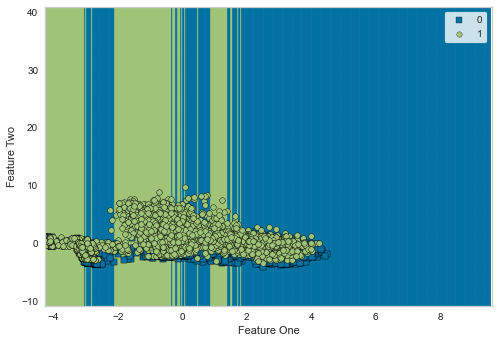

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [255]:
plot_model(tuned_light_OPTUNA,plot='boundary')

In [260]:
plot_model(tuned_light_OPTUNA,plot='parameter')

,Parameters
boosting_type,gbdt
class_weight,None
colsample_bytree,1.0
importance_type,split
learning_rate,0.24990381615951443
max_depth,-1
min_child_samples,75
min_child_weight,0.001
min_split_gain,0.7234936612672493
n_estimators,136


Visual Rendered Successfully
plot_model() succesfully completed......................................


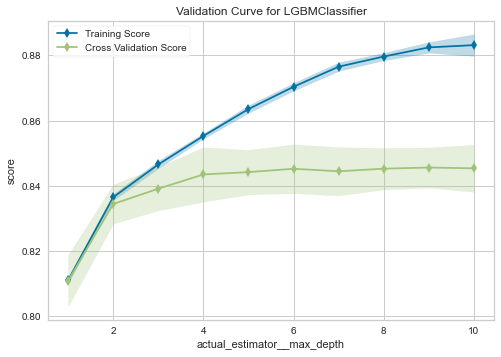

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [261]:
plot_model(tuned_light_OPTUNA,plot='vc')

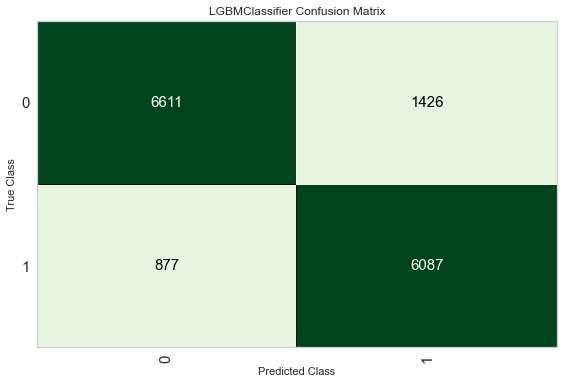

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [259]:
plot_model(tuned_light_OPTUNA,plot='confusion_matrix')

In [41]:
predictions = predict_model(lightgbm)
#Get the misclassifications
predictions.loc[(predictions['STATUS_NAME'] != predictions['Label'])]

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,Light Gradient Boosting Machine,0.8477,0.9306,0.8591,0.8212,0.8397,0.6949,0.6955,22629000


,AGENT_PERSISTENCY,PREMIUM_AMOUNT,Policy_Age,SA,TERM,GENDER_F,GENDER_M,GENDER_N,MARITAL_STATUS_Divorced,MARITAL_STATUS_Other,...,Policy_Age_multiply_MARITAL_STATUS_Single,SALES_CHANNEL_Tied_multiply_Policy_Age,SALES_CHANNEL_Tied_multiply_MODE_NAME_GSO,MODE_NAME_GSO_multiply_SALES_CHANNEL_Tied,INCOME_9.0_multiply_TERM,PRODUCT_CODE_MFDS-1_multiply_TERM,SALES_CHANNEL_Tied_multiply_PREMIUM_AMOUNT,STATUS_NAME,Label,Score
0,0.632626,0.111979,-0.617459,0.344936,0.784207,1.0,0.0,0.0,0.0,0.0,...,-0.617459,-0.000000,0.0,0.0,0.000000,0.000000,0.000000,Inforce,Lapsed,0.6200
9,-1.403001,0.702097,0.117305,3.017850,-1.274245,1.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,-1.274245,-0.000000,0.000000,Lapsed,Inforce,0.5146
11,-1.403001,-1.037752,0.117305,-0.197988,0.785279,0.0,1.0,0.0,0.0,0.0,...,0.117305,0.117305,0.0,0.0,0.785279,0.000000,-1.037752,Inforce,Lapsed,0.7143
28,1.363712,0.345291,0.810964,3.019691,-1.272727,1.0,0.0,0.0,0.0,0.0,...,0.000000,0.810964,0.0,0.0,-1.272727,-0.000000,0.345291,Inforce,Lapsed,0.5180
29,-0.800468,-0.827705,0.468417,-0.843188,-1.273270,1.0,0.0,0.0,0.0,0.0,...,0.468417,0.468417,0.0,0.0,-0.000000,-0.000000,-0.827705,Inforce,Lapsed,0.6212
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14947,-1.403001,-1.307469,0.468417,0.085327,0.785279,0.0,0.0,1.0,0.0,0.0,...,0.468417,0.468417,0.0,0.0,0.785279,0.000000,-1.307469,Inforce,Lapsed,0.8196
14967,0.344590,0.017325,-0.998204,-0.843188,-1.273811,0.0,1.0,0.0,0.0,0.0,...,-0.998204,-0.998204,0.0,0.0,-0.000000,-1.273811,0.017325,Lapsed,Inforce,0.8822
14974,-1.403001,-1.215344,-0.617459,-0.571847,0.784207,1.0,0.0,0.0,0.0,0.0,...,-0.617459,-0.617459,0.0,0.0,0.784207,0.000000,-1.215344,Inforce,Lapsed,0.6234
14993,1.494893,1.680522,-0.617459,3.024210,0.783671,0.0,1.0,0.0,0.0,0.0,...,-0.000000,-0.617459,0.0,0.0,0.000000,0.000000,1.680522,Lapsed,Inforce,0.7598


In [29]:
# explain original model
exp = explainer.explain_instance(
    data_row=X_test.iloc[5],      #Data row is a single observation from the data set
    predict_fn=lightgbm.predict_proba,  #Making predictions
    num_features=5
)

exp.show_in_notebook(show_table=True,show_predicted_value=True)  #Visualise the prediction interpretation

NameError: name 'explainer' is not defined

In [40]:
#Visualise exact probabilities
#The probabilities [0(inforce),1(lapse)]
exp.predict_proba

array([6.79169391e-04, 9.99320831e-01])

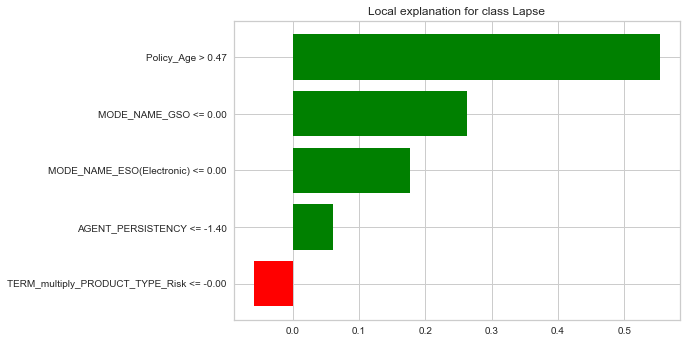

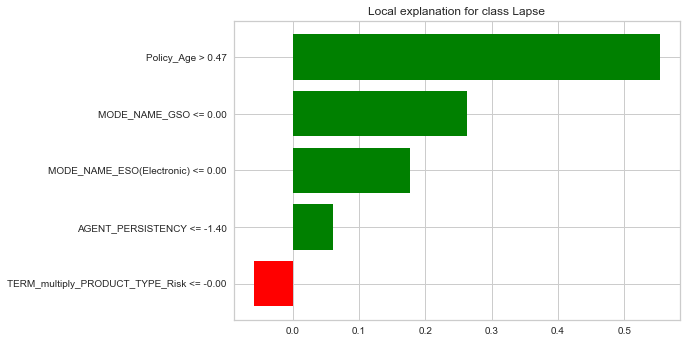

In [42]:
exp.as_pyplot_figure()

In [37]:
#wrong prediction
exp = explainer.explain_instance(
    data_row=X_test.iloc[5],      #Data row is a single observation from the data set
    predict_fn=tuned_light_OPTUNA2.predict_proba,  #Making predictions
    num_features=5
)

exp.show_in_notebook(show_table=True,show_predicted_value=True)  #Visualise the prediction interpretation

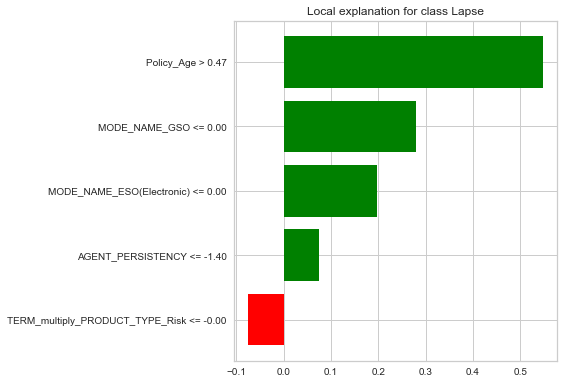

In [38]:
plt=exp.as_pyplot_figure()
plt.tight_layout()

In [43]:
interpret_model(tuned_light_OPTUNA2,plot='reason',observation =5)

Initializing interpret_model()
interpret_model(estimator=LGBMClassifier(bagging_fraction=0.9295090189269537, bagging_freq=2,
               boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               feature_fraction=0.8066047681522839, importance_type='split',
               learning_rate=0.1937324396509947, max_depth=-1,
               min_child_samples=25, min_child_weight=0.001,
               min_split_gain=0.15821707893247786, n_estimators=272, n_jobs=-1,
               num_leaves=171, objective=None, random_state=8755,
               reg_alpha=1.557592620646393, reg_lambda=8.045525719180284e-09,
               silent=True, subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0), use_train_data=False, X_new_sample=None, feature=None, kwargs={}, observation=5, plot=reason, save=False)
Checking exceptions
plot type: reason
model type detected: type 1
Creating TreeExplainer
Compiling shap values
model type detected: LGBMClassifier


Visual Rendered Successfully
interpret_model() succesfully completed......................................


# Blending models

In [52]:
Xgboost=create_model('xgboost',round=2) #high precision

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.86,0.94,0.89,0.82,0.86,0.72,0.72
1,0.86,0.94,0.89,0.82,0.85,0.72,0.72
2,0.86,0.94,0.89,0.82,0.85,0.72,0.72
3,0.86,0.94,0.89,0.82,0.85,0.71,0.72
4,0.86,0.94,0.88,0.82,0.85,0.71,0.71
5,0.86,0.94,0.89,0.82,0.85,0.72,0.72
6,0.86,0.94,0.89,0.82,0.85,0.71,0.72
7,0.86,0.94,0.89,0.82,0.85,0.72,0.72
8,0.86,0.94,0.89,0.82,0.85,0.72,0.72
9,0.86,0.94,0.89,0.82,0.85,0.72,0.72


create_model_container: 1
master_model_container: 1
display_container: 3
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=8755, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0)
create_model() succesfully completed......................................


In [56]:
calibrate_model(Xgboost)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8615,0.9436,0.8898,0.8260,0.8567,0.7231,0.7250
1,0.8601,0.9419,0.8886,0.8220,0.8540,0.7201,0.7221
2,0.8603,0.9422,0.8874,0.8241,0.8546,0.7204,0.7223
3,0.8580,0.9404,0.8891,0.8180,0.8521,0.7161,0.7184
4,0.8574,0.9398,0.8816,0.8240,0.8518,0.7146,0.7162
5,0.8594,0.9411,0.8845,0.8247,0.8536,0.7187,0.7203
6,0.8590,0.9408,0.8860,0.8224,0.8530,0.7179,0.7198
7,0.8611,0.9427,0.8882,0.8253,0.8556,0.7222,0.7240
8,0.8605,0.9434,0.8864,0.8251,0.8547,0.7208,0.7226
9,0.8606,0.9424,0.8886,0.8248,0.8555,0.7211,0.7230


create_model_container: 4
master_model_container: 4
display_container: 6
CalibratedClassifierCV(base_estimator=XGBClassifier(base_score=0.5,
                                                    booster='gbtree',
                                                    colsample_bylevel=1,
                                                    colsample_bynode=1,
                                                    colsample_bytree=1, gamma=0,
                                                    gpu_id=-1,
                                                    importance_type='gain',
                                                    interaction_constraints='',
                                                    learning_rate=0.300000012,
                                                    max_delta_step=0,
                                                    max_depth=6,
                                                    min_child_weight=1,
                                                    missin

CalibratedClassifierCV(base_estimator=XGBClassifier(base_score=0.5,
                                                    booster='gbtree',
                                                    colsample_bylevel=1,
                                                    colsample_bynode=1,
                                                    colsample_bytree=1, gamma=0,
                                                    gpu_id=-1,
                                                    importance_type='gain',
                                                    interaction_constraints='',
                                                    learning_rate=0.300000012,
                                                    max_delta_step=0,
                                                    max_depth=6,
                                                    min_child_weight=1,
                                                    missing=nan,
                                                    monotone_const

In [53]:
qda= create_model('qda')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7677,0.8601,0.8508,0.7085,0.7731,0.5392,0.5487
1,0.7658,0.8582,0.8546,0.7018,0.7707,0.5361,0.5470
2,0.7636,0.8567,0.8481,0.7026,0.7685,0.5313,0.5412
3,0.7516,0.8531,0.8912,0.6738,0.7674,0.5116,0.5349
4,0.7644,0.8568,0.8537,0.7033,0.7712,0.5331,0.5438
5,0.7639,0.8558,0.8574,0.7003,0.7709,0.5325,0.5441
6,0.7632,0.8570,0.8543,0.6993,0.7691,0.5310,0.5422
7,0.7644,0.8562,0.8490,0.7036,0.7695,0.5328,0.5426
8,0.7653,0.8572,0.8495,0.7044,0.7701,0.5347,0.5445
9,0.7658,0.8592,0.8528,0.7050,0.7719,0.5357,0.5460


create_model_container: 2
master_model_container: 2
display_container: 4
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
create_model() succesfully completed......................................


In [54]:
#List of models
models=[Xgboost,qda]

In [55]:
#Blending
blender = blend_models(models)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8044,0.9199,0.8724,0.7488,0.8058,0.6111,0.6184
1,0.8039,0.9187,0.8752,0.7441,0.8043,0.6103,0.6184
2,0.8009,0.9176,0.8710,0.7430,0.8019,0.6043,0.6121
3,0.7813,0.9191,0.9075,0.7032,0.7924,0.5690,0.5899
4,0.8015,0.9168,0.8743,0.7437,0.8038,0.6055,0.6136
5,0.8000,0.9180,0.8762,0.7400,0.8024,0.6029,0.6117
6,0.8011,0.9169,0.8770,0.7402,0.8028,0.6051,0.6140
7,0.8032,0.9180,0.8713,0.7464,0.8041,0.6088,0.6162
8,0.8031,0.9190,0.8718,0.7458,0.8039,0.6087,0.6162
9,0.8026,0.9184,0.8734,0.7454,0.8044,0.6077,0.6155


create_model_container: 3
master_model_container: 3
display_container: 5
VotingClassifier(estimators=[('xgboost',
                              XGBClassifier(base_score=0.5, booster='gbtree',
                                            colsample_bylevel=1,
                                            colsample_bynode=1,
                                            colsample_bytree=1, gamma=0,
                                            gpu_id=-1, importance_type='gain',
                                            interaction_constraints='',
                                            learning_rate=0.300000012,
                                            max_delta_step=0, max_depth=6,
                                            min_child_weight=1, missing=nan,
                                            monotone_constraints='()',
                                            n_estimators=100, n_jobs=-1...
                                            objective='binary:logistic',
             

In [35]:
evaluate_model(blender)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [40]:
blender

StackingClassifier(cv=KFold(n_splits=10, random_state=RandomState(MT19937) at 0x232BD8BC640,
   shuffle=False),
                   estimators=[('xgboost',
                                XGBClassifier(base_score=0.5, booster='gbtree',
                                              colsample_bylevel=1,
                                              colsample_bynode=1,
                                              colsample_bytree=1, gamma=0,
                                              gpu_id=-1, importance_type='gain',
                                              interaction_constraints='',
                                              learning_rate=0.300000012,
                                              max_delta_step=0, max_dept...
                                                              reg_param=0.0,
                                                              store_covariance=False,
                                                              tol=0.0001))],
             

In [42]:
calibrated_blender=calibrate_model(blender)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
0,0.8557,0.9330,0.8533,0.8339,0.8435,0.7097,0.7099,5173000.0000
1,0.8574,0.9378,0.8612,0.8381,0.8495,0.7141,0.7143,5360000.0000
2,0.8443,0.9273,0.8513,0.8195,0.8351,0.6877,0.6882,5216000.0000
3,0.8531,0.9316,0.8693,0.8271,0.8477,0.7061,0.7069,5421000.0000
4,0.8489,0.9342,0.8767,0.8084,0.8412,0.6975,0.6995,5272000.0000
5,0.8546,0.9361,0.8631,0.8241,0.8431,0.7077,0.7084,5180000.0000
6,0.8460,0.9267,0.8503,0.8256,0.8378,0.6913,0.6915,5274000.0000
7,0.8631,0.9377,0.8753,0.8342,0.8543,0.7254,0.7262,5337000.0000
8,0.8531,0.9325,0.8770,0.8147,0.8447,0.7058,0.7075,5274000.0000
9,0.8508,0.9325,0.8577,0.8316,0.8445,0.7012,0.7015,5381000.0000


In [ ]:
exp1 = explainer.explain_instance(
    data_row=X_test.iloc[1], 
    predict_fn=blender.predict_proba
)

exp1.show_in_notebook(show_table=True,show_predicted_value=True)

In [ ]:
#Evaluate the model
evaluate_model(blender)

In [ ]:
#caliberate the model

In [ ]:
caliberated_tuned=calibrate_model(blender)

In [ ]:
evaluate_model(caliberated_tuned)

# Entire Data Set

In [50]:
#Set up an experiement
exp=setup(df,target='STATUS_NAME',train_size=0.99,
          imputation_type='simple',
          ignore_low_variance=True,
          numeric_imputation='mean',categorical_imputation='mode',
          fix_imbalance=True,
          normalize=True ,  #Rescaling
          transformation= True,
          feature_interaction=True,
          feature_ratio= True,
          feature_selection= True,   #new
          feature_selection_threshold= 0.2,  #new
          bin_numeric_features=['Policy_holder_Age','INCOME'],
          session_id= 8755, # control randomness,
          fold_strategy='kfold',
          high_cardinality_features=['PRODUCT_CODE']  #new
          
          )

,Description,Value
0,session_id,8755
1,Target,STATUS_NAME
2,Target Type,Binary
3,Label Encoded,"Inforce: 0, Lapsed: 1"
4,Original Data,"(389153, 17)"
5,Missing Values,True
6,Numeric Features,7
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,True


create_model_container: 0
master_model_container: 0
display_container: 1
Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[],
                                      target='STATUS_NAME', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_s...
                 Advanced_Feature_Selection_Classic(ml_usecase='classification',
                                                    n_jobs=-1,
                                                    random_state=8755

In [51]:
light_AllData=create_model('lightgbm',round=2,cross_validation=False)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8499,0.9341,0.8753,0.8127,0.8428,0.6997,0.7014


display_container: 2
LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=8755, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
create_models() succesfully completed......................................


In [47]:
mlp=create_model('mlp', round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.83,0.92,0.85,0.80,0.82,0.67,0.67
1,0.83,0.92,0.85,0.80,0.83,0.67,0.67
2,0.83,0.92,0.86,0.80,0.83,0.66,0.67
3,0.84,0.92,0.86,0.81,0.83,0.67,0.67
4,0.83,0.92,0.85,0.80,0.83,0.67,0.67
5,0.83,0.92,0.86,0.79,0.82,0.66,0.67
6,0.83,0.92,0.85,0.80,0.83,0.67,0.67
7,0.84,0.92,0.87,0.80,0.83,0.67,0.68
8,0.83,0.92,0.86,0.79,0.83,0.67,0.67
9,0.83,0.92,0.87,0.79,0.83,0.66,0.67


create_model_container: 2
master_model_container: 2
display_container: 3
MLPClassifier(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
              beta_2=0.999, early_stopping=False, epsilon=1e-08,
              hidden_layer_sizes=(100,), learning_rate='constant',
              learning_rate_init=0.001, max_fun=15000, max_iter=500,
              momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
              power_t=0.5, random_state=8755, shuffle=True, solver='adam',
              tol=0.0001, validation_fraction=0.1, verbose=False,
              warm_start=False)
create_model() succesfully completed......................................


In [ ]:
get_metrics()